# このページについて
このページでは，研究・学習・教育を目的として，鈴木大慈先生の著作『[確率的最適化](https://www.kspub.co.jp/book/detail/1529076.html)』（講談社）に基づく内容の要約・補足・解説を行っています．  

# 注意
このページは著作権法第32条（引用）および第30条（私的使用のための複製）の趣旨に従い，原著の価値や意図を損なうことなく，個人の学習を目的として構成されています．

このページの内容は原著の代替ではなく，必ず原書の購読を推奨いたします．  
著者および出版社の知的財産権を尊重する立場から，不適切な記載や引用が含まれていた場合には，速やかに修正・削除等の対応をいたします．

万が一，著作権等の侵害に該当する箇所がある場合には，以下の GitHub の issue または pull request，あるいは Discussionsにてご連絡いただけますと幸いです．

# 確率的勾配降下法
確率的勾配降下法とは，ある分布からのサンプル(確率変数の実現値)を用いて勾配を推定し，それを用いてパラメータを更新するというものです．
## 最急降下法，射影勾配法
### アルゴリズム
**入力**
* *$\ell_t(\beta)$：損失関数
*$\mathcal{B} \subseteq \mathbb{R}^p$：射影(凸集合)
*$\Pi_{\mathcal{B}}$：射影(集合$\mathcal{B}$への射影)
*$\eta_t > 0$($t=1, 2, \ldots$)
*$T$：総ステップ数

**出力**
*$\beta_T$：パラメータ

**手順**
1.  **初期化:**
 $\beta_0 = \mathbf{0} \in \mathbb{R}^p$と初期化する．
2.  **繰り返し (時刻$t=1, 2, \ldots, T$で以下を実行):**
    2.1$z_t \sim P(Z)$を観測する．
    2.2$\beta_{t-1}$における損失関数$\ell_t(\cdot)$の劣勾配$g_t \in \partial \ell_t(\beta_{t-1})$を計算する．
    2.3  パラメータ$\beta_t$を次のように更新する：
$$
\beta_t = \Pi_{\mathcal{B}}\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\tag{1}
$$

(1)の更新式について，$g_t$は$z_t$劣勾配ですが，$\mathrm{E}_{z_t}[g_t]$は，損失関数の期待値$L(\beta) = \mathrm{E}_{z_t}[\ell_t(\beta)]$の$\beta_{t-1}$における劣勾配になります．ですので，この更新は目的関数の勾配（または劣勾配）方向に進む勾配法とみなすことができます．
$\beta_{t-1}$から$g_t$の方向にステップ幅$1/\eta_t$だけ進む操作を行っています．ただ，パラメータ自体は，$\mathcal{B}$内にあるという制約を持っているので，$\mathcal{B}$からパラメータの更新値が外れてしまった場合は$\mathcal{B}$の中に最も近い点に射影$\Pi_{\mathcal{B}}$して戻すという方法を行い場合があります．これを用いた方法は**射影勾配法**といいます，また射影を用いない場合は一般的に**勾配降下法，最急降下法**と呼びます．また，真の勾配の代わりに$g_t$を用いる方法を，**確率的勾配降下法**と呼びます．

## 正則化項を含んだ確率的勾配降下法
アルゴリズムを見ると，パラメータの更新のみが異なりますが，(1)の一般化とみなすことができます．
### アルゴリズム
1.  **初期化:**
   $\beta_0 = \mathbf{0} \in \mathbb{R}^p$と初期化する．

2.  **繰り返し (時刻$t=1, 2, \ldots, T$で以下を実行):**
    2.1$z_t \sim P(Z)$を観測する．
    2.2$\beta_{t-1}$における損失関数$\ell_t(\cdot)$の劣勾配$g_t \in \partial \ell_t(\beta_{t-1})$を計算する．
    2.3  パラメータ$\beta_t$を次のように更新する：
$$
\beta_t=\underset{\beta \in \mathcal{B}}{\operatorname{argmin}}\left\{\left\langle g_t, \beta\right\rangle+\psi(\beta)+\frac{\eta_t}{2}\left\|\beta-\beta_{t-1}\right\|^2\right\} \tag{2}
$$
(2)は，(1)の一般化になっています．正則化項$\psi=0$かつパラメータ空間$\mathcal{B} = \mathbb{R}^p$の場合，更新式 (1)は$\beta_t = \beta_{t-1} - \frac{1}{\eta_t} g_t$となり，射影のない勾配降下法の更新式に一致します．また，$\psi=0$で$\mathcal{B}$への射影がある場合は，射影勾配法の更新式と一致します．
詳しく見ていきましょう．平方完成を使って導出します．
最初に，ノルムの二乗を内積で展開しましょう．
$$
\left\|\beta-\beta_{t-1}\right\|^2=\left\langle\beta-\beta_{t-1}, \beta-\beta_{t-1}\right\rangle=\|\beta\|^2-2\left\langle\beta, \beta_{t-1}\right\rangle+\left\|\beta_{t-1}\right\|^2
$$
これを，(2)に代入すると，
$$
\begin{aligned}
&\left\langle g_t, \beta\right\rangle+\frac{\eta_t}{2}\left(\|\beta\|^2-2\left\langle\beta, \beta_{t-1}\right\rangle+\left\|\beta_{t-1}\right\|^2\right) \\
& =\left\langle g_t, \beta\right\rangle+\frac{\eta_t}{2}\|\beta\|^2-\eta_t\left\langle\beta, \beta_{t-1}\right\rangle+\frac{\eta_t}{2}\left\|\beta_{t-1}\right\|^2
\end{aligned}
$$
となります．次に，$\beta$に関して平方完成を行います．以下は$\beta$に対して注目した場合の上記の右辺になります．
$$
f(\beta)=\left\langle g_t, \beta\right\rangle+\frac{\eta_t}{2}\|\beta\|^2-\eta_t\left\langle\beta, \beta_{t-1}\right\rangle
$$
結果として，以下のようになります．
$$
\begin{aligned}
& \frac{\eta_t}{2}\left\|\beta-\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\right\|^2 \\
& =\frac{\eta_t}{2}\left(\|\beta\|^2-2\left\langle\beta, \beta_{t-1}-\frac{1}{\eta_t} g_t\right\rangle+\left\|\beta_{t-1}-\frac{1}{\eta_t} g_t\right\|^2\right) \\
& \left.=\frac{\eta_t}{2}\|\beta\|^2-\eta_t\left\langle\beta, \beta_{t-1}\right\rangle+\left\langle\beta, g_t\right\rangle+\text { (定数項 }\right)
\end{aligned}
$$
よって，
$$
\left\langle g_t, \beta\right\rangle+\frac{\eta_t}{2}\left\|\beta-\beta_{t-1}\right\|^2=\frac{\eta_t}{2}\left\|\beta-\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\right\|^2-\frac{1}{2 \eta_t}\left\|g_t\right\|^2
$$
となります．最後に，右辺を最小化する$\beta$を求めたいわけですが，最適化に依存する項だけを見ると，以下のようになります．
$$
\beta_t=\arg \min _{\beta \in \mathcal{B}}\left\|\beta-\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\right\|^2
$$
定義より，これは以下のような射影勾配法におけるパラメータ更新と同じといえます．
$$
\beta_t=\Pi_{\mathcal{B}}\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)
$$
### (2)式の分解
$$
\beta_t=\arg \min _{\beta \in \mathcal{B}}[\underbrace{\left\langle g_t, \beta\right\rangle}_{\text {損失の線形近似 }}+\underbrace{\psi(\beta)}_{\text {正則化 }}+\underbrace{\frac{\eta_t}{2}\left\|\beta-\beta_{t-1}\right\|^2}_{\text {ステップの抑制}}]
$$
**第一項**：
現在のパラメータにおける損失関数$l_{t}(\beta)$の一次線形近似を示しています．一時線形近似とはどういうことかというと，劣勾配を用いれば損失関数$l_{t}(\beta)$は以下のように展開できます．
$$
\ell_t(\beta) \approx \ell_t\left(\beta_{t-1}\right)+\left\langle g_t, \beta-\beta_{t-1}\right\rangle
$$
右辺第二項が，まさにその線形近似を示しています．

**第二項**：
これは正則化項です．特にコメントはないですが，第一項と組み合わせると正則化損失の一時線形近似になっています．

**第三項**：
更新に対するペナルティを与えます．パラメータの設計によっては更新に対して保守的になったり，ならなかったりします．

## 近接勾配法
近接写像とは，射影の一般化のことを言います．射影勾配法の以下のパラメータ更新を近接写像で書き換えてみましょう．近接写像の定義は以下の通りです．
$$
\operatorname{prox}_{\psi / \eta_t}^{\mathcal{B}}\left(\beta^{\prime}\right):=\arg \min _{\beta \in \mathcal{B}}\left\{\frac{1}{\eta_t} \psi(\beta)+\frac{1}{2}\left\|\beta-\beta^{\prime}\right\|^2\right\}
$$
最初に，式変形を行っていきます．
$$
\beta_t=\arg \min _{\beta \in \mathcal{B}}\left\{\left\langle g_t, \beta\right\rangle+\psi(\beta)+\frac{\eta_t}{2}\left\|\beta-\beta_{t-1}\right\|^2\right\}
$$
両辺に$1 / \eta_t$を掛けます．
$$
=\arg \min _{\beta \in \mathcal{B}}\left\{\left\langle\frac{1}{\eta_t} g_t, \beta\right\rangle+\frac{1}{\eta_t} \psi(\beta)+\frac{1}{2}\left\|\beta-\beta_{t-1}\right\|^2\right\}
$$
次にノルム二乗項を展開します．
$$
\left\|\beta-\beta_{t-1}\right\|^2=\left\langle\beta-\beta_{t-1}, \beta-\beta_{t-1}\right\rangle=\|\beta\|^2-2\left\langle\beta, \beta_{t-1}\right\rangle+\left\|\beta_{t-1}\right\|^2
$$
そうすると，argminの中身は以下のように変形できます．
$$
\begin{aligned}
& \left\langle\frac{1}{\eta_t} g_t, \beta\right\rangle+\frac{1}{\eta_t} \psi(\beta)+\frac{1}{2}\left(\|\beta\|^2-2\left\langle\beta, \beta_{t-1}\right\rangle+\left\|\beta_{t-1}\right\|^2\right) \\
& =\frac{1}{\eta_t} \psi(\beta)+\left\langle\frac{1}{\eta_t} g_t-\beta_{t-1}, \beta\right\rangle+\frac{1}{2}\|\beta\|^2+\text{定数項}
\end{aligned}
$$
次に，平方完成を思い出すと，以下の式が成り立ちます．
$$
\frac{1}{2}\|\beta\|^2+\langle \beta_{t-1}-\frac{1}{\eta_t} g_t, \beta\rangle=\frac{1}{2}\|\beta+\beta_{t-1}-\frac{1}{\eta_t} g_t\|^2-\frac{1}{2}\|\beta_{t-1}-\frac{1}{\eta_t} g_t\|^2
$$
わかりにくいので，$b=\beta_{t-1}-\frac{1}{\eta_t} g_t$とすると，
$$
\frac{1}{2}\|\beta\|^2+\langle b, \beta\rangle=\frac{1}{2}\|\beta+b\|^2-\frac{1}{2}\|b\|^2
$$
となります．つまり，平方完成で以下のようになります．
$$
\left\langle\frac{1}{\eta_t} g_t, \beta\right\rangle+\frac{1}{2}\left\|\beta-\beta_{t-1}\right\|^2=\frac{1}{2}\left\|\beta-\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\right\|^2-\frac{1}{2 \eta_t^2}\left\|g_t\right\|^2
$$
これを使って$\beta_t$を展開しましょう．
$$
\begin{aligned}
\beta_t & =\arg \min _{\beta \in \mathcal{B}}\left\{\frac{1}{\eta_t} \psi(\beta)+\left\langle\frac{1}{\eta_t} g_t, \beta\right\rangle+\frac{1}{2}\left\|\beta-\beta_{t-1}\right\|^2\right\} \\
& =\arg \min _{\beta \in \mathcal{B}}\left\{\frac{1}{\eta_t} \psi(\beta)+\frac{1}{2}\left\|\beta-\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)\right\|^2\right\}
\end{aligned}
$$
近接写像の定義は
$$
\operatorname{prox}_{\psi / \eta_t}^{\mathcal{B}}(v):=\arg \min _{\beta \in \mathcal{B}}\left\{\frac{1}{\eta_t} \psi(\beta)+\frac{1}{2}\|\beta-v\|^2\right\}
$$
なので，上の上の式は，
$$
\beta_t=\operatorname{prox}_{\psi / \eta_t}^{\mathcal{B}}\left(\beta_{t-1}-\frac{1}{\eta_t} g_t\right)
$$
となります．よって，近接写像で射影勾配法を一般化できました．もし，確率的勾配推定を行わない場合，これを**近接勾配法**といいます．

### 収束のしやすさと$\psi$
今のところ，正則化項は目的関数に和の形で加わっていますが，目的関数事態を，正則化項を含んだ形で最適化するという方法もあります．しかし，これはパラメータ更新の部分で大きな違いを生みます．
**目的関数に正則化項を含んだ場合**
$$
\beta_t=\beta_{t-1}-\frac{1}{\eta_t}\left(g_t+\nabla \psi\left(\beta_{t-1}\right)\right)
$$
**目的関数＋正則化項**
$$
\beta_t=\beta_{t-1}-\frac{1}{\eta_t}\left(g_t+\nabla \psi\left(\beta_t\right)\right)
$$
$\psi$の勾配が，パラメータ更新前と後の$\beta$になっています．基本的には，単調性がある場合は更新後のパラメータのほうが良いものとされているため，後者のほうがより良い収束レートを示すことが分かっています．

## 確率的勾配降下法の収束レート
収束レートを議論するために，仮定を置きます．

**仮定1**
* すべての$t$に対して，以下を満たすような定数$G > 0$が存在します．
$$
\mathbb{E}\left[\left\|g_t\right\|^2\right] \leq G^2
$$
勾配ノルムの期待値が有界であるということが言えます．これは，$l$の$\beta$に関するリプシッツ連続性によって保証されます．リプシッツ連続性とはつまり，
$$
\left\|\ell(z, \beta)-\ell\left(z, \beta^{\prime}\right)\right\| \leq G \cdot\left\|\beta-\beta^{\prime}\right\|
$$
**仮定2**
$$
\mathbf{0} \in \mathcal{B}
$$
証明が簡単になる仮定です．収束評価をする際には，$\left\|\beta-\beta^*\right\|^2$を上から押さえたいというモチベーションがあります．もし，仮定2が成り立つならば，最適解$\beta^*$を原点にとって考えることができます．例えば$D$で$\beta$の大きさを定義することを考えると原点が最適解なので以下のように変形することができます．
$$
\sup _{\beta \in \mathcal{B}}\|\beta\|^2=D^2 \quad \Rightarrow \quad\left\|\beta-\beta^*\right\|^2=\|\beta\|^2 \leq D^2
$$
一方で，原点が含まれていないと，常に$\left\|\beta-\beta^*\right\|$の形で表現するしかありません．最適解はもちろん明示的ではないので以下のような不等式評価が難しくなります．
$$
\forall \beta \in \mathcal{B}, \quad\left\|\beta-\beta^*\right\| \leq D
$$
### 収束レート(定理4.3.2)
****
任意の $\beta^* \in \mathcal{B}$ に対して，上記の仮定のもとで
$$
\mathbb{E}_{z_{1: 2}}\left[\left\|\beta_t-\beta^*\right\|^2\right] \leq D^2 \quad(\forall t \geq 1)
$$
が成り立つと仮定しします．さらにステップサイズを $\eta_t-\eta_0 \sqrt{t}$ とすると，平均化点
$$
\bar{\beta}_t=\frac{1}{T+1} \sum_{t=0}^T \beta_t
$$
及び，$z$の系列
$$
z_{1: t}=\left(z_1, \ldots, z_t\right)
$$

に対して以下が成立します．
$$
\mathbb{E}_{z_{1: T}}\left[L_\psi\left(\bar{\beta}_T\right)\right]-L_\psi\left(\beta^*\right) \leq \frac{\eta_0 D^2+\frac{G^2}{\eta_{0}}}{\sqrt{T+1}}
$$
****

**確率的勾配降下法はミニマックス最適**
ここで，$D$という形は，明示的ではありません．ですので，以下のように$R$を新たに定義します．
$$
R:=\sup _{\beta, \beta^{\prime} \in \mathcal{B}}\left\|\beta-\beta^{\prime}\right\| \quad \Rightarrow \quad R^2 \geq D^2
$$
これは$\mathcal{B}$の最大距離であり，集合の直径といえます．よって，
$$
\left\|\beta_t-\beta^*\right\| \leq R \quad \text { for all } \beta_t, \beta^* \in \mathcal{B}
$$
です．$D^2 \leq R^2$を定理の上界に代入し，$\eta_0=\frac{G}{R}$とすれば，
$$
\mathbb{E}_{z_{1: T}}\left[L_\psi\left(\bar{\beta}_T\right)\right]-L_\psi\left(\beta^*\right) \leq \frac{2 R G}{\sqrt{T+1}}
$$
となります．最終的に，オーダー形式で書くと
$$
\mathbb{E}\left[L_\psi\left(\bar{\beta}_T\right)\right]-L_\psi\left(\beta^*\right) \leq O\left(\frac{1}{\sqrt{T}}\right)
$$
であり，これは任意の一次法のアルゴリズム(一次勾配を用いたアルゴリズム)において改善ができないミニマックス下界を示しています．つまり，
$$
\inf _{\text {Algorhythm}} \sup _{f \in \mathcal{F}} \mathbb{E}\left[f\left(\bar{\beta}_T\right)-f\left(\beta^*\right)\right]=\Theta\left(\frac{1}{\sqrt{T}}\right)
$$
です．これは，誤差を最大化させる最悪ケースの関数に対してそれを最小化するアルゴリズムが与える誤差のオーダーが$\frac{1}{\sqrt{T} }$であるということです．つまり，SGD+正則化はミニマックス最適です．

**正則化項が収束レートに現れない**
例えば劣勾配をもちいて，パラメータを更新することを考えると，以下のようになります．
$$
\beta_t=\beta_{t-1}-\eta_t\left(g_t+\nabla \psi\left(\beta_{t-1}\right)\right)
$$
ここでは，正則化の勾配を直接計算しなければいけません．例えば，正則化項がL1ノルムであることを考えると，
$$
\left\|\beta-\beta^{\prime}\right\|_1 \leq \sqrt{p}\left\|\beta-\beta^{\prime}\right\|_2
$$
上界はこのように与えられます．$p$は次元数です．
$$
\|\beta\|_1=\sum_{i=1}^p\left|\beta_i\right| \leq \sqrt{p}\left(\sum_{i=1}^p \beta_i^2\right)^{1 / 2}=\sqrt{p}\|\beta\|_2
$$
であることを考えると，次元数分計算しないといけないし，次元数の√分L1ノルムの上界に現れます．これは収束レートをとても遅くします．なぜなら勾配を計算する場合次元数分計算しないといけないからです．

## 確率的勾配降下法の動きを見てみよう．

Animation size has reached 21122927 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


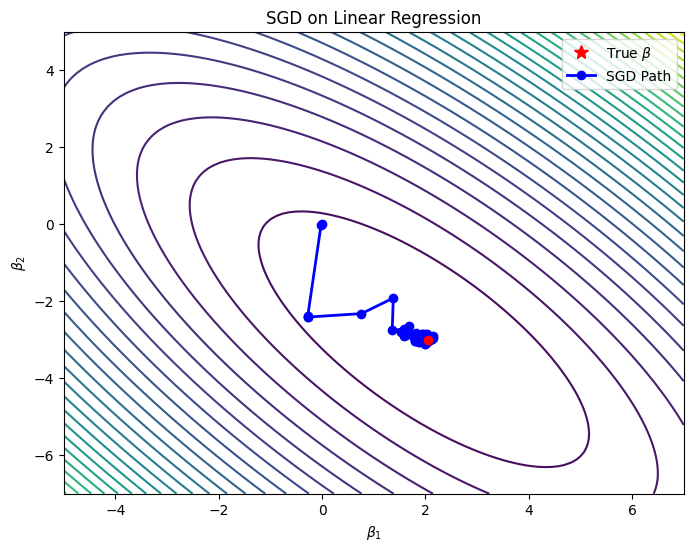

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# --- データ生成 ---
np.random.seed(0)
beta_true = np.array([2.0, -3.0])
N = 100
X = np.random.rand(N, 2) * 10
y = X @ beta_true + np.random.randn(N)

# --- 損失関数（等高線表示用） ---
beta1_vals = np.linspace(-5, 7, 100)
beta2_vals = np.linspace(-7, 5, 100)
B1, B2 = np.meshgrid(beta1_vals, beta2_vals)
Z = np.array([
    np.mean((y - X @ np.array([b1, b2]))**2) / 2
    for b1, b2 in zip(B1.ravel(), B2.ravel())
]).reshape(B1.shape)

# --- SGD アルゴリズム ---
learning_rate = 0.01
n_iter = 100
beta = np.array([0.0, 0.0])
beta_history = [beta.copy()]

for _ in range(n_iter):
    i = np.random.randint(N)
    grad = (X[i] @ beta - y[i]) * X[i]
    beta -= learning_rate * grad
    beta_history.append(beta.copy())

beta_history = np.array(beta_history)

# --- アニメーションプロット設定 ---
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_title("SGD on Linear Regression")
ax.set_xlabel(r"$\beta_1$")
ax.set_ylabel(r"$\beta_2$")
ax.contour(B1, B2, Z, levels=30, cmap="viridis")
ax.plot(beta_true[0], beta_true[1], "r*", label="True $\\beta$", markersize=10)
line, = ax.plot([], [], 'bo-', label="SGD Path", lw=2)
point, = ax.plot([], [], 'ro', markersize=6)
ax.legend()

def init():
    line.set_data([], [])
    point.set_data([], [])
    return line, point

def update(frame):
    line.set_data(beta_history[:frame+1, 0], beta_history[:frame+1, 1])
    point.set_data([beta_history[frame, 0]], [beta_history[frame, 1]])
    return line, point


ani = animation.FuncAnimation(fig, update, frames=len(beta_history),
                              init_func=init, blit=True, interval=100)

# --- Jupyter Notebook用表示 ---
HTML(ani.to_jshtml())
